<a href="https://colab.research.google.com/github/yjkno1/AI_TEAM/blob/main/IsolationForest_HTTP_0401.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**필요파일 Import**


In [ ]:
import csv
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.ensemble import IsolationForest

import ftplib
import os
import pickle
from os import unlink

import plotly.express as px

# Google Drive 에서 파일 가져올때 사용
# from google.colab import drive
# drive.mount('/gdrive', force_remount=True)


**Dataframe 생성**

In [ ]:
# 위와같이 파일을 읽을때 date 컬럼의 타입을 지정할수 있고
# df['srvtime'] = pd.to_datetime(df['srvtime]) 이런형태로 나중에 변경 할수도 있다.

#csv_file = "http://yjkno1.synology.me:8081/file/ROUGHING_MILL_STAND10_ACTUAL_CURRENT_sample.csv"

csv_file = "http://yjkno1.synology.me:8081/file/http_csv.csv"

# 가져올 비율 0.1 은 10%
per = 0.7
df = pd.read_csv(csv_file, skiprows = lambda x:x>0 and np.random.rand() > per)

rDf = pd.read_csv(csv_file)

df.describe()

df.info()

df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 397376 entries, 0 to 397375
Data columns (total 5 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   time_stamp  397376 non-null  int64  
 1   value_1     397376 non-null  float64
 2   value_2     397376 non-null  float64
 3   value_3     397376 non-null  float64
 4   abnomal     397376 non-null  int64  
dtypes: float64(3), int64(2)
memory usage: 15.2 MB


,time_stamp,value_1,value_2,value_3,abnomal
0,1,-2.302585,5.371103,10.716107,0
1,2,-2.302585,5.088213,8.418058,0
2,3,-2.302585,5.464255,7.113224,0
3,4,-2.302585,5.451468,7.616825,0
4,5,-2.302585,5.476882,6.186414,0
...,...,...,...,...,...
397371,567489,-2.302585,5.656341,7.682068,0
397372,567490,-2.302585,5.673667,6.999514,0
397373,567492,-2.302585,5.069533,9.668278,0
397374,567494,-2.302585,5.357058,7.735477,0


**index 기준 Metric 만들기**


In [ ]:
x_train = df


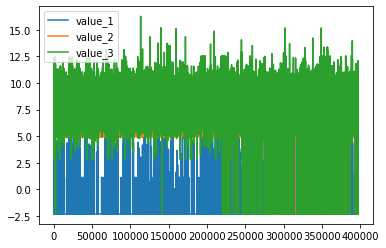

In [ ]:
x_train[["value_1", "value_2", "value_3"]].plot()

**Model 만들기 함수**

In [ ]:
def isolation_forest_model(state_seed=20, n_estimators=100, max_samples=128, contamination=float(0.004)):
  state_value = np.random.RandomState(state_seed)
  return IsolationForest(n_estimators=n_estimators, max_samples=max_samples, contamination=contamination, random_state=state_value)


# ftp 접속 후 ftp객체 반환
def ftp_login(host, port, user, password):
  ftp=ftplib.FTP()
  ftp.connect(host,port)
  ftp.login(user, password)
  ftp.cwd("./")
  return ftp

# model을 ftp로 업로드
def save_model_to_ftp(ftp, filename):
  myfile = open(filename,'wb')
  # Save model
  pickle.dump(isol, myfile)
  ftpFile = open(filename, 'rb')
  ftp.storbinary("STOR /share/"+filename, ftpFile)
  myfile.close()
  ftpFile.close()

# ftp에서 model을 Load
def load_model_to_ftp(ftp, filename):
  myfile = open(filename,'wb')
  ftp.retrbinary("RETR /share/"+filename, myfile.write)
  myfile.close()
  ftpFile = open(filename, 'rb')
  isol = pickle.load(ftpFile)
  ftpFile.close()
  return isol



**Model 생성**

In [ ]:
isol = isolation_forest_model(20, 100, 128, float(0.004))

isol

IsolationForest(behaviour='deprecated', bootstrap=False, contamination=0.004,
                max_features=1.0, max_samples=128, n_estimators=100,
                n_jobs=None,
                random_state=RandomState(MT19937) at 0x7F49E11105A0, verbose=0,
                warm_start=False)

In [ ]:
isol.fit(x_train[["value_1", "value_2", "value_3"]])


IsolationForest(behaviour='deprecated', bootstrap=False, contamination=0.004,
                max_features=1.0, max_samples=128, n_estimators=100,
                n_jobs=None,
                random_state=RandomState(MT19937) at 0x7F49E11105A0, verbose=0,
                warm_start=False)

In [ ]:
#x_test = rDf[rDf.eq(df).any(axis=1) == False].copy()
x_test = rDf
x_test


#x_test[["value_1", "value_2", "value_3"]]

,time_stamp,value_1,value_2,value_3,abnomal
0,1,-2.302585,5.371103,10.716107,0
1,2,-2.302585,5.088213,8.418058,0
2,3,-2.302585,5.464255,7.113224,0
3,4,-2.302585,5.451468,7.616825,0
4,5,-2.302585,5.476882,6.186414,0
...,...,...,...,...,...
567493,567494,-2.302585,5.357058,7.735477,0
567494,567495,-2.302585,5.389528,5.464255,0
567495,567496,-2.302585,5.384954,8.191491,0
567496,567497,-2.302585,5.389528,7.118097,0


In [ ]:
# Model 저장해 두기.
filename="iForest_HTTP.model"

ftp = ftp_login("yjkno1.synology.me", 2121, "ftp_user", "wnsxhtm1212")

# Model 저장하기
save_model_to_ftp(ftp, filename)

# Model 불러오기
i_sol = load_model_to_ftp(ftp, filename)

print(i_sol)


IsolationForest(behaviour='deprecated', bootstrap=False, contamination=0.004,
                max_features=1.0, max_samples=128, n_estimators=100,
                n_jobs=None,
                random_state=RandomState(MT19937) at 0x7F49E1110D10, verbose=0,
                warm_start=False)


In [ ]:
series = isol.predict(x_test[["value_1", "value_2", "value_3"]])
print(series)
print(series.size)
x_test = x_test.reset_index()

x_test['outliers']= pd.Series(series).apply(lambda x: '1' if (x == -1) else '0' )

print(x_test)
print(series.size)

# 이상데이터 건수
print(x_test[x_test['outliers']=='1'].count())

# 정상데이터 건수
print(x_test[x_test['outliers']=='0'].count())

print(x_test.isnull().sum().sum())

print(x_test)

[1 1 1 ... 1 1 1]
567498
         index  time_stamp   value_1   value_2    value_3  abnomal outliers
0            0           1 -2.302585  5.371103  10.716107        0        0
1            1           2 -2.302585  5.088213   8.418058        0        0
2            2           3 -2.302585  5.464255   7.113224        0        0
3            3           4 -2.302585  5.451468   7.616825        0        0
4            4           5 -2.302585  5.476882   6.186414        0        0
...        ...         ...       ...       ...        ...      ...      ...
567493  567493      567494 -2.302585  5.357058   7.735477        0        0
567494  567494      567495 -2.302585  5.389528   5.464255        0        0
567495  567495      567496 -2.302585  5.384954   8.191491        0        0
567496  567496      567497 -2.302585  5.389528   7.118097        0        0
567497  567497      567498 -2.302585  5.389528   7.001337        0        0

[567498 rows x 7 columns]
567498
index         2230
time_stamp

**평가**

In [ ]:
from sklearn.metrics import confusion_matrix

x_test["outliers"] = pd.to_numeric(x_test["outliers"])

x_test.info()

confusion_matrix(x_test[["abnomal"]], x_test[["outliers"]])

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 567498 entries, 0 to 567497
Data columns (total 7 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   index       567498 non-null  int64  
 1   time_stamp  567498 non-null  int64  
 2   value_1     567498 non-null  float64
 3   value_2     567498 non-null  float64
 4   value_3     567498 non-null  float64
 5   abnomal     567498 non-null  int64  
 6   outliers    567498 non-null  int64  
dtypes: float64(3), int64(4)
memory usage: 30.3 MB


array([[565200,     87],
       [    68,   2143]])

In [ ]:
from sklearn.metrics import classification_report

print(x_test[["abnomal"]])
print(x_test[["outliers"]])

print(classification_report(x_test[["abnomal"]], x_test[["outliers"]], target_names=['class 0', 'class 1']))

        abnomal
0             0
1             0
2             0
3             0
4             0
...         ...
567493        0
567494        0
567495        0
567496        0
567497        0

[567498 rows x 1 columns]
        outliers
0              0
1              0
2              0
3              0
4              0
...          ...
567493         0
567494         0
567495         0
567496         0
567497         0

[567498 rows x 1 columns]
              precision    recall  f1-score   support

     class 0       1.00      1.00      1.00    565287
     class 1       0.96      0.97      0.97      2211

    accuracy                           1.00    567498
   macro avg       0.98      0.98      0.98    567498
weighted avg       1.00      1.00      1.00    567498



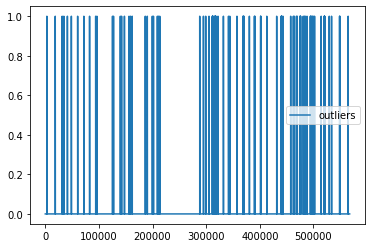

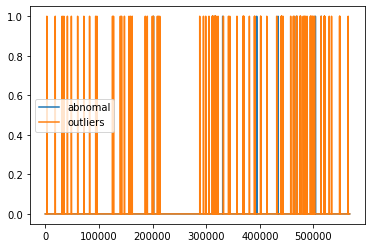

In [ ]:
x_test[["outliers"]].plot()
x_test[["abnomal", "outliers"]].plot()

**Scatter 그래프 API를 사용하여 데이터 시각화**


In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=4, cols=1,
                    subplot_titles=['value_1','value_2','value_3', 'Anomaly'])

clr = ["red" if out == 1 else 'blue' for out in x_test['outliers']]
clr2 = ["red" if out == 1 else 'orange' for out in x_test['outliers']]
clr3 = ["red" if out == 1 else 'green' for out in x_test['outliers']]
clr4 = ["red" if out == 1 else 'white' for out in x_test['abnomal']]

fig.add_trace(go.Scatter(x=x_test.time_stamp, y=x_test.value_1, name="value_1",  mode="markers", marker=dict(color=clr)), row=1, col=1)
fig.add_trace(go.Scatter(x=x_test.time_stamp, y=x_test.value_2, name="value_2",  mode="markers", marker=dict(color=clr2)), row=2, col=1)
fig.add_trace(go.Scatter(x=x_test.time_stamp, y=x_test.value_3, name="value_3",  mode="markers", marker=dict(color=clr3)), row=3, col=1)
fig.add_trace(go.Scatter(x=x_test.time_stamp, y=x_test.abnomal, name="abnomal",  mode="markers", marker=dict(color=clr4)), row=4, col=1)

fig.update_layout(height=800, width=1000, title_text="Timeseries Tag")
fig.show()